## Enrichment Analysis of Osmotic Stress RNA-seq data

In this notebook we will carry out the enrichment analysis of the differentially expressed genes obtained from the osmotic stress RNA-seq data. The objective of this is to find the key underlying biological processes and pathways from the differentially expressed genes at different conditions.

### Loading the libraries

The main libraries we will need for this analysis are:

- ViSEAGO
- org.Hs.eg.db (annotations for human genes)
- GO.db

In [1]:
Libraries <- c("ViSEAGO","org.Hs.eg.db","GO.db")
suppressMessages(lapply(Libraries, require, character.only=T))

[[1]]
[1] TRUE

[[2]]
[1] TRUE

[[3]]
[1] TRUE

### Extracting annotation

To extract annotations we have to first convert the gene names into Entrez IDs. We can load the necessary mappings from the package `org.Hs.eg.db` which was loaded initially.

In [2]:
xx <- as.list(org.Hs.egSYMBOL2EG)
head(xx)

$A1BG
[1] "1"

$A2M
[1] "2"

$A2MP1
[1] "3"

$NAT1
[1] "9"

$NAT2
[1] "10"

$NATP
[1] "11"

Now we need to load the background list of genes from "allGenes.txt" and find corresponding Entrez IDs.

In [3]:
background <- scan(file = "allGenes.txt", quiet=T, what="")
background.eg <- xx[background]
head(background.eg)

$FLT3LG
[1] "2323"

$ERI1
[1] "90459"

$SAP130
[1] "79595"

$LOC100129098
[1] "100129098"

$SPIN1
[1] "10927"

$SGPL1
[1] "8879"

### Loading annotation with ViSEAGO and creating topGO data objects

The next task will be to load the annotations from the annotation database `org.Hs.eg.db` as a `ViSEAGO` object and then use it to create `topGO` objects needed to perform the enrichment analysis

In [4]:
Bioconductor <- ViSEAGO::Bioconductor2GO()
osmGENE2GO <- ViSEAGO::annotate("org.Hs.eg.db", Bioconductor)

'select()' returned 1:many mapping between keys and columns


### Time point - 6h

First we will import the data for 6h and do the annotations.

#### Data Import

Next we will load the data for a set of differentially expressed genes, obtain corresponding Entrez IDs and view it to make sure the import was successful

In [5]:
fitdata.6h <- read.table("fitdata.6h.txt", sep = "\t")
genes.6h <- xx[rownames(fitdata.6h)]
head(genes.6h)

$CYP2C9
[1] "1559"

$IL1R2
[1] "7850"

$NSG2
[1] "51617"

$CHRM5
[1] "1133"

$INPP5J
[1] "27124"

$FNDC7
[1] "163479"

Next we can create the topGO data object and perform the enrichment analysis

In [6]:
BP_genes.6h <- ViSEAGO::create_topGOdata(geneSel=genes.6h, 
                                         allGenes=background.eg, 
                                         gene2GO=osmGENE2GO, 
                                         ont = "BP", nodeSize=5)

allGenes contain genes redondancy.
duplicate elements were removed.
geneSel contain genes redondancy.
duplicate elements were removed.
Loading required package: topGO
Loading required package: graph
Loading required package: SparseM

Attaching package: ‘SparseM’

The following object is masked from ‘package:base’:

    backsolve


groupGOTerms: 	GOBPTerm, GOMFTerm, GOCCTerm environments built.

Attaching package: ‘topGO’

The following object is masked from ‘package:IRanges’:

    members


Building most specific GOs .....
	( 11924 GO terms found. )

Build GO DAG topology ..........
	( 15903 GO terms and 37764 relations. )

Annotating nodes ...............
	( 15288 genes annotated to the GO terms. )


Next we can run the Fisher test with this topGO data object to obtain the annotations

In [7]:
elim_BP_genes.6h <- topGO::runTest(BP_genes.6h, algorithm = "elim", statistic="fisher", cutOff = 0.01)


			 -- Elim Algorithm -- 

		 the algorithm is scoring 8596 nontrivial nodes
		 parameters: 
			 test statistic: fisher
			 cutOff: 0.01

	 Level 19:	1 nodes to be scored	(0 eliminated genes)

	 Level 18:	7 nodes to be scored	(0 eliminated genes)

	 Level 17:	16 nodes to be scored	(0 eliminated genes)

	 Level 16:	41 nodes to be scored	(0 eliminated genes)

	 Level 15:	100 nodes to be scored	(8 eliminated genes)

	 Level 14:	188 nodes to be scored	(8 eliminated genes)

	 Level 13:	330 nodes to be scored	(118 eliminated genes)

	 Level 12:	520 nodes to be scored	(1906 eliminated genes)

	 Level 11:	804 nodes to be scored	(2399 eliminated genes)

	 Level 10:	1045 nodes to be scored	(2683 eliminated genes)

	 Level 9:	1205 nodes to be scored	(4510 eliminated genes)

	 Level 8:	1203 nodes to be scored	(4718 eliminated genes)

	 Level 7:	1164 nodes to be scored	(5378 eliminated genes)

	 Level 6:	969 nodes to be scored	(6408 eliminated genes)

	 Level 5:	568 nodes to be scored	(6769 elimin

We can view the list of genes using `GenTable()` function as below

In [8]:
tab.6h <- topGO::GenTable(BP_genes.6h, 
                          raw.p.value = elim_BP_genes.6h, 
                          topNodes = length(elim_BP_genes.6h@score), 
                          numChar = 120)
head(tab.6h)

GO.ID,Term,Annotated,Significant,Expected,raw.p.value
GO:0006541,glutamine metabolic process,21,15,5.02,5.6e-06
GO:0000122,negative regulation of transcription by RNA polymerase II,786,238,187.86,1.6e-05
GO:0090630,activation of GTPase activity,94,41,22.47,2.0e-05
GO:0045944,positive regulation of transcription by RNA polymerase II,1109,321,265.06,3.5e-05
GO:0043065,positive regulation of apoptotic process,610,188,145.80,4.1e-05
GO:0045746,negative regulation of Notch signaling pathway,40,21,9.56,8.6e-05


We can use the function showSigofNodes to plot GO graph for 3 most significant terms and their parents

Loading required package: Rgraphviz
Loading required package: grid

Attaching package: ‘grid’

The following object is masked from ‘package:topGO’:

    depth


Attaching package: ‘Rgraphviz’

The following objects are masked from ‘package:IRanges’:

    from, to

The following objects are masked from ‘package:S4Vectors’:

    from, to



$dag
A graphNEL graph with directed edges
Number of Nodes = 85 
Number of Edges = 189 

$complete.dag
[1] "A graph with 85 nodes."


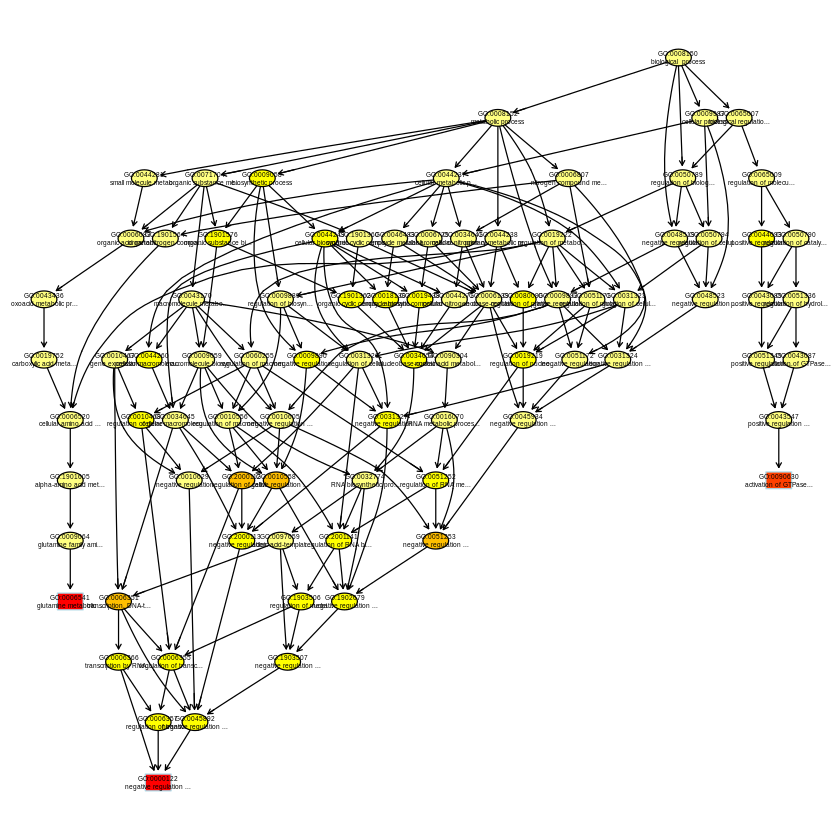

In [9]:
par(cex=0.3)
topGO::showSigOfNodes(BP_genes.6h, score(elim_BP_genes.6h), firstSigNodes = 3, useInfo = "def")

### Time point - 12h

Now we can repeat the above analysis for 12 hours time points. We will put all the steps together below

In [10]:
fitdata.12h <- read.table("fitdata.12h.txt", sep = "\t")
genes.12h <- xx[rownames(fitdata.12h)]

In [11]:
BP_genes.12h <- ViSEAGO::create_topGOdata(geneSel=genes.12h, 
                                         allGenes=background.eg, 
                                         gene2GO=osmGENE2GO, 
                                         ont = "BP", nodeSize=5)

allGenes contain genes redondancy.
duplicate elements were removed.
geneSel contain genes redondancy.
duplicate elements were removed.

Building most specific GOs .....
	( 11924 GO terms found. )

Build GO DAG topology ..........
	( 15903 GO terms and 37764 relations. )

Annotating nodes ...............
	( 15288 genes annotated to the GO terms. )


In [12]:
elim_BP_genes.12h <- topGO::runTest(BP_genes.12h, algorithm = "elim", statistic="fisher", cutOff = 0.01)


			 -- Elim Algorithm -- 

		 the algorithm is scoring 8845 nontrivial nodes
		 parameters: 
			 test statistic: fisher
			 cutOff: 0.01

	 Level 19:	1 nodes to be scored	(0 eliminated genes)

	 Level 18:	7 nodes to be scored	(0 eliminated genes)

	 Level 17:	15 nodes to be scored	(0 eliminated genes)

	 Level 16:	39 nodes to be scored	(7 eliminated genes)

	 Level 15:	104 nodes to be scored	(15 eliminated genes)

	 Level 14:	193 nodes to be scored	(15 eliminated genes)

	 Level 13:	340 nodes to be scored	(214 eliminated genes)

	 Level 12:	539 nodes to be scored	(852 eliminated genes)

	 Level 11:	836 nodes to be scored	(1308 eliminated genes)

	 Level 10:	1089 nodes to be scored	(2076 eliminated genes)

	 Level 9:	1244 nodes to be scored	(2784 eliminated genes)

	 Level 8:	1232 nodes to be scored	(4138 eliminated genes)

	 Level 7:	1195 nodes to be scored	(5047 eliminated genes)

	 Level 6:	994 nodes to be scored	(8113 eliminated genes)

	 Level 5:	577 nodes to be scored	(8906 elimi

In [13]:
tab.12h <- topGO::GenTable(BP_genes.12h, 
                          raw.p.value = elim_BP_genes.12h, 
                          topNodes = length(elim_BP_genes.12h@score), 
                          numChar = 120)
head(tab.12h)

GO.ID,Term,Annotated,Significant,Expected,raw.p.value
GO:0006206,pyrimidine nucleobase metabolic process,16,12,4.59,0.00016
GO:0045727,positive regulation of translation,117,52,33.55,0.00019
GO:0006446,regulation of translational initiation,74,36,21.22,0.00021
GO:0010506,regulation of autophagy,315,125,90.33,0.00022
GO:0031297,replication fork processing,32,19,9.18,0.00028
GO:0043065,positive regulation of apoptotic process,610,224,174.92,0.00036


$dag
A graphNEL graph with directed edges
Number of Nodes = 69 
Number of Edges = 165 

$complete.dag
[1] "A graph with 69 nodes."


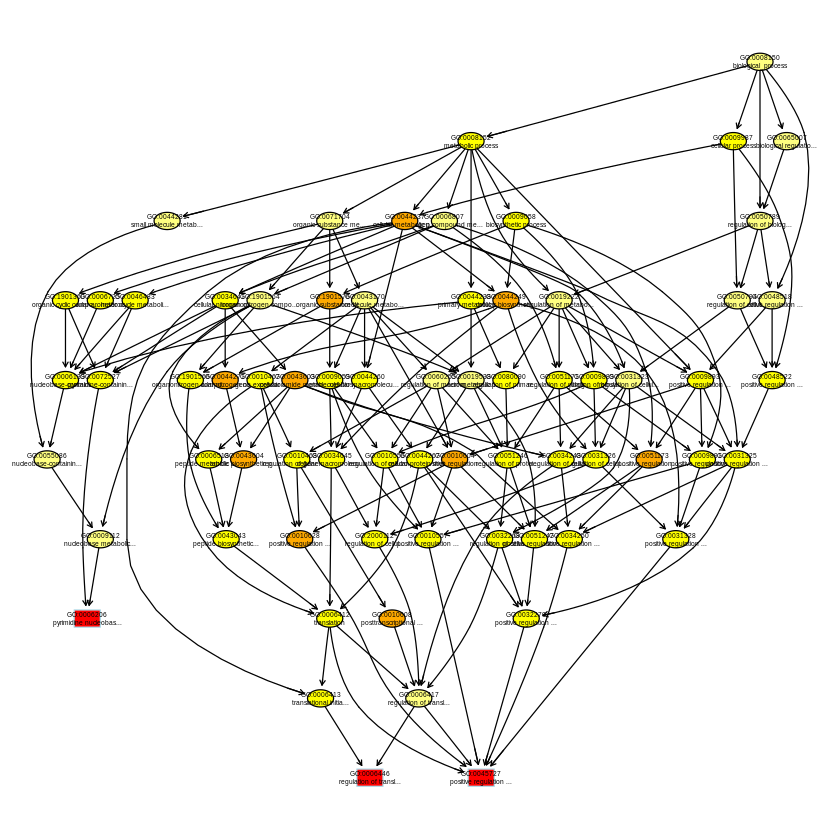

In [14]:
par(cex=0.3)
topGO::showSigOfNodes(BP_genes.12h, score(elim_BP_genes.12h), firstSigNodes = 3, useInfo = "def")

### Time point - 24h

Same analysis now done for 24 hour time points

In [15]:
fitdata.24h <- read.table("fitdata.24h.txt", sep = "\t")
genes.24h <- xx[rownames(fitdata.24h)]

In [16]:
BP_genes.24h <- ViSEAGO::create_topGOdata(geneSel=genes.24h, 
                                         allGenes=background.eg, 
                                         gene2GO=osmGENE2GO, 
                                         ont = "BP", nodeSize=5)

allGenes contain genes redondancy.
duplicate elements were removed.
geneSel contain genes redondancy.
duplicate elements were removed.

Building most specific GOs .....
	( 11924 GO terms found. )

Build GO DAG topology ..........
	( 15903 GO terms and 37764 relations. )

Annotating nodes ...............
	( 15288 genes annotated to the GO terms. )


In [17]:
elim_BP_genes.24h <- topGO::runTest(BP_genes.24h, algorithm = "elim", statistic="fisher", cutOff = 0.01)


			 -- Elim Algorithm -- 

		 the algorithm is scoring 8958 nontrivial nodes
		 parameters: 
			 test statistic: fisher
			 cutOff: 0.01

	 Level 19:	1 nodes to be scored	(0 eliminated genes)

	 Level 18:	8 nodes to be scored	(0 eliminated genes)

	 Level 17:	16 nodes to be scored	(0 eliminated genes)

	 Level 16:	42 nodes to be scored	(0 eliminated genes)

	 Level 15:	109 nodes to be scored	(0 eliminated genes)

	 Level 14:	200 nodes to be scored	(21 eliminated genes)

	 Level 13:	348 nodes to be scored	(78 eliminated genes)

	 Level 12:	542 nodes to be scored	(773 eliminated genes)

	 Level 11:	848 nodes to be scored	(1030 eliminated genes)

	 Level 10:	1097 nodes to be scored	(1926 eliminated genes)

	 Level 9:	1258 nodes to be scored	(2542 eliminated genes)

	 Level 8:	1245 nodes to be scored	(4169 eliminated genes)

	 Level 7:	1211 nodes to be scored	(5489 eliminated genes)

	 Level 6:	1008 nodes to be scored	(6324 eliminated genes)

	 Level 5:	584 nodes to be scored	(7501 elimin

In [18]:
tab.24h <- topGO::GenTable(BP_genes.24h, 
                          raw.p.value = elim_BP_genes.24h, 
                          topNodes = length(elim_BP_genes.24h@score), 
                          numChar = 120)
head(tab.24h)

GO.ID,Term,Annotated,Significant,Expected,raw.p.value
GO:0032201,telomere maintenance via semi-conservative replication,27,22,9.30,7.1e-07
GO:0032508,DNA duplex unwinding,108,66,37.22,3.9e-06
GO:0006364,rRNA processing,209,110,72.02,7.4e-06
GO:0000727,double-strand break repair via break-induced replication,11,11,3.79,8.1e-06
GO:0017148,negative regulation of translation,125,66,43.07,1.8e-05
GO:1900182,positive regulation of protein localization to nucleus,72,45,24.81,1.9e-05


$dag
A graphNEL graph with directed edges
Number of Nodes = 52 
Number of Edges = 79 

$complete.dag
[1] "A graph with 52 nodes."


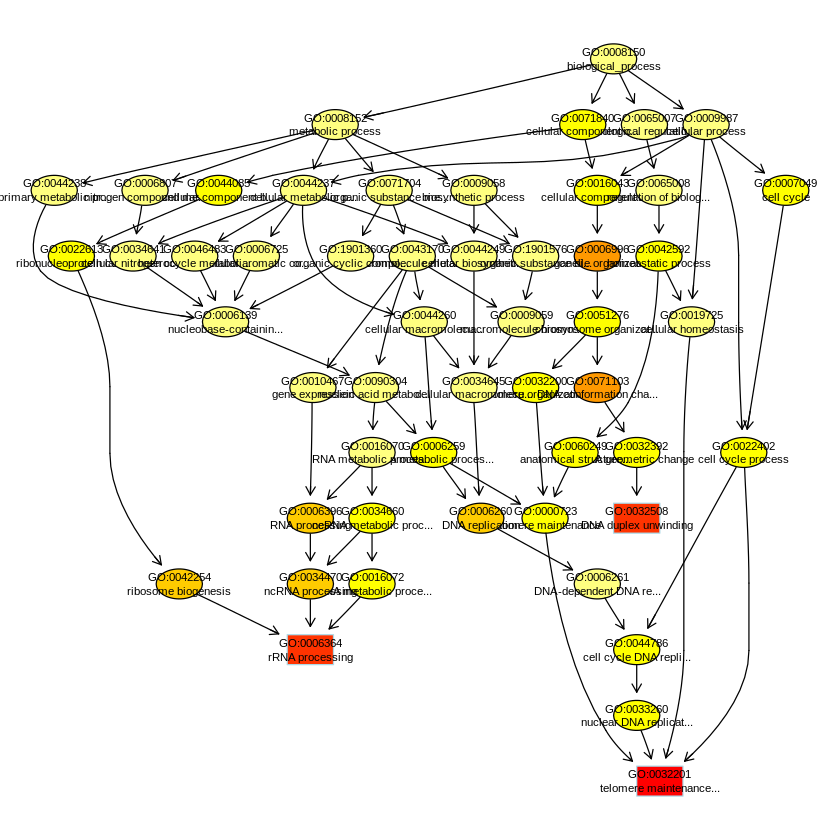

In [19]:
par(cex=0.3)
topGO::showSigOfNodes(BP_genes.24h, score(elim_BP_genes.24h), firstSigNodes = 3, useInfo = "def")

### Time point - 48h

Same analysis with 48h time points

In [20]:
fitdata.48h <- read.table("fitdata.48h.txt", sep = "\t")
genes.48h <- xx[rownames(fitdata.48h)]

In [21]:
BP_genes.48h <- ViSEAGO::create_topGOdata(geneSel=genes.48h, 
                                         allGenes=background.eg, 
                                         gene2GO=osmGENE2GO, 
                                         ont = "BP", nodeSize=5)

allGenes contain genes redondancy.
duplicate elements were removed.
geneSel contain genes redondancy.
duplicate elements were removed.

Building most specific GOs .....
	( 11924 GO terms found. )

Build GO DAG topology ..........
	( 15903 GO terms and 37764 relations. )

Annotating nodes ...............
	( 15288 genes annotated to the GO terms. )


In [22]:
elim_BP_genes.48h <- topGO::runTest(BP_genes.48h, algorithm = "elim", statistic="fisher", cutOff = 0.01)


			 -- Elim Algorithm -- 

		 the algorithm is scoring 9015 nontrivial nodes
		 parameters: 
			 test statistic: fisher
			 cutOff: 0.01

	 Level 19:	1 nodes to be scored	(0 eliminated genes)

	 Level 18:	7 nodes to be scored	(0 eliminated genes)

	 Level 17:	16 nodes to be scored	(0 eliminated genes)

	 Level 16:	42 nodes to be scored	(0 eliminated genes)

	 Level 15:	108 nodes to be scored	(19 eliminated genes)

	 Level 14:	198 nodes to be scored	(27 eliminated genes)

	 Level 13:	350 nodes to be scored	(133 eliminated genes)

	 Level 12:	548 nodes to be scored	(637 eliminated genes)

	 Level 11:	856 nodes to be scored	(1386 eliminated genes)

	 Level 10:	1107 nodes to be scored	(2606 eliminated genes)

	 Level 9:	1269 nodes to be scored	(3476 eliminated genes)

	 Level 8:	1262 nodes to be scored	(4788 eliminated genes)

	 Level 7:	1214 nodes to be scored	(6509 eliminated genes)

	 Level 6:	1010 nodes to be scored	(7297 eliminated genes)

	 Level 5:	584 nodes to be scored	(7695 elim

In [23]:
tab.48h <- topGO::GenTable(BP_genes.48h, 
                          raw.p.value = elim_BP_genes.48h, 
                          topNodes = length(elim_BP_genes.48h@score), 
                          numChar = 120)
head(tab.48h)

GO.ID,Term,Annotated,Significant,Expected,raw.p.value
GO:0000184,"nuclear-transcribed mRNA catabolic process, nonsense-mediated decay",119,98,44.34,4.7e-24
GO:0006614,SRP-dependent cotranslational protein targeting to membrane,94,82,35.02,9.9e-24
GO:0019083,viral transcription,174,114,64.83,2.9e-14
GO:0006413,translational initiation,187,116,69.67,4.4e-12
GO:0051301,cell division,572,306,213.12,1.8e-11
GO:0016032,viral process,801,414,298.44,2.3e-08


$dag
A graphNEL graph with directed edges
Number of Nodes = 75 
Number of Edges = 127 

$complete.dag
[1] "A graph with 75 nodes."


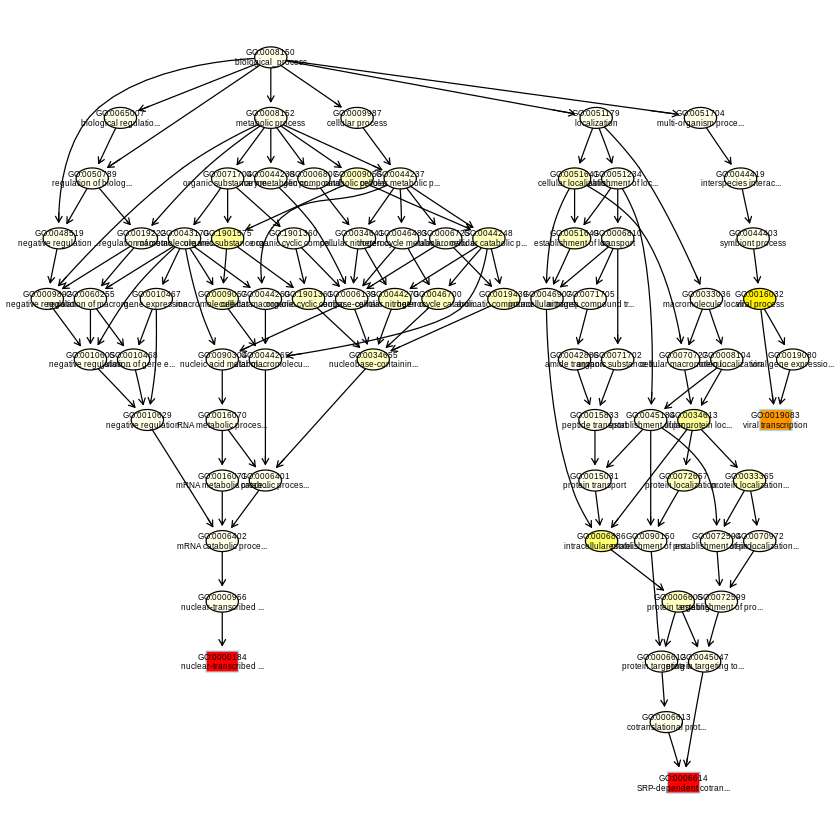

In [24]:
par(cex=0.3)
topGO::showSigOfNodes(BP_genes.48h, score(elim_BP_genes.48h), firstSigNodes = 3, useInfo = "def")

### Time point - 72h

Same analysis for 72 hour time points.

In [25]:
fitdata.72h <- read.table("fitdata.72h.txt", sep = "\t")
genes.72h <- xx[rownames(fitdata.72h)]

In [26]:
BP_genes.72h <- ViSEAGO::create_topGOdata(geneSel=genes.72h, 
                                         allGenes=background.eg, 
                                         gene2GO=osmGENE2GO, 
                                         ont = "BP", nodeSize=5)

allGenes contain genes redondancy.
duplicate elements were removed.
geneSel contain genes redondancy.
duplicate elements were removed.

Building most specific GOs .....
	( 11924 GO terms found. )

Build GO DAG topology ..........
	( 15903 GO terms and 37764 relations. )

Annotating nodes ...............
	( 15288 genes annotated to the GO terms. )


In [27]:
elim_BP_genes.72h <- topGO::runTest(BP_genes.72h, algorithm = "elim", statistic="fisher", cutOff = 0.01)


			 -- Elim Algorithm -- 

		 the algorithm is scoring 8936 nontrivial nodes
		 parameters: 
			 test statistic: fisher
			 cutOff: 0.01

	 Level 19:	1 nodes to be scored	(0 eliminated genes)

	 Level 18:	7 nodes to be scored	(0 eliminated genes)

	 Level 17:	16 nodes to be scored	(0 eliminated genes)

	 Level 16:	41 nodes to be scored	(0 eliminated genes)

	 Level 15:	107 nodes to be scored	(25 eliminated genes)

	 Level 14:	198 nodes to be scored	(45 eliminated genes)

	 Level 13:	349 nodes to be scored	(96 eliminated genes)

	 Level 12:	544 nodes to be scored	(378 eliminated genes)

	 Level 11:	848 nodes to be scored	(979 eliminated genes)

	 Level 10:	1094 nodes to be scored	(2155 eliminated genes)

	 Level 9:	1263 nodes to be scored	(2625 eliminated genes)

	 Level 8:	1245 nodes to be scored	(3970 eliminated genes)

	 Level 7:	1202 nodes to be scored	(6079 eliminated genes)

	 Level 6:	999 nodes to be scored	(7104 eliminated genes)

	 Level 5:	580 nodes to be scored	(8152 elimina

In [28]:
tab.72h <- topGO::GenTable(BP_genes.72h, 
                          raw.p.value = elim_BP_genes.72h, 
                          topNodes = length(elim_BP_genes.72h@score), 
                          numChar = 120)
head(tab.72h)

GO.ID,Term,Annotated,Significant,Expected,raw.p.value
GO:0000184,"nuclear-transcribed mRNA catabolic process, nonsense-mediated decay",119,84,38.00,4.7e-18
GO:0006614,SRP-dependent cotranslational protein targeting to membrane,94,69,30.02,1.6e-16
GO:0006413,translational initiation,187,102,59.72,1.1e-10
GO:0019083,viral transcription,174,95,55.56,4.5e-10
GO:0051301,cell division,572,255,182.66,1.4e-08
GO:0030335,positive regulation of cell migration,465,199,148.49,3.9e-07


$dag
A graphNEL graph with directed edges
Number of Nodes = 85 
Number of Edges = 155 

$complete.dag
[1] "A graph with 85 nodes."


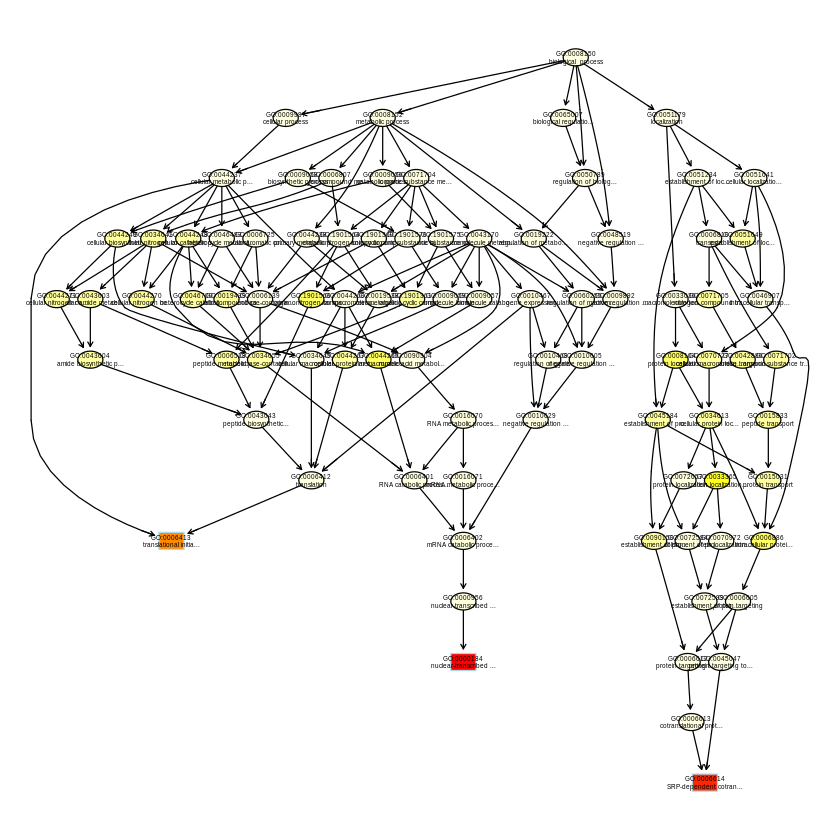

In [29]:
par(cex=0.3)
topGO::showSigOfNodes(BP_genes.72h, score(elim_BP_genes.72h), firstSigNodes = 3, useInfo = "def")

### Merge results and visualize

Now that we obtained the analysis for the different time points we can merge them together in a single object and then use it for further visualizations. This will be done with the `merge_enrich_terms()` function.

In [30]:
BP_osm.sresults <- ViSEAGO::merge_enrich_terms(Input=list(
    Time6h=c("BP_genes.6h", "elim_BP_genes.6h"),
    Time12h=c("BP_genes.12h", "elim_BP_genes.12h"),
    Time24h=c("BP_genes.24h", "elim_BP_genes.24h"),
    Time48h=c("BP_genes.48h", "elim_BP_genes.48h"),
    Time72h=c("BP_genes.72h", "elim_BP_genes.72h")))

'select()' returned 1:1 mapping between keys and columns
'select()' returned 1:1 mapping between keys and columns
'select()' returned 1:1 mapping between keys and columns
'select()' returned 1:1 mapping between keys and columns
'select()' returned 1:1 mapping between keys and columns
'select()' returned 1:1 mapping between keys and columns


We can visualize a summary of the data as below

In [31]:
BP_osm.sresults

- object class: enrich_GO_terms
- ontology: BP
- input:
        Time6h: elim
        Time12h: elim
        Time24h: elim
        Time48h: elim
        Time72h: elim
- topGO summary:
 Time6h
      BP_genes.6h 
        description: Bioconductor org.Hs.eg.db 2019-Jul10
        available_genes: 17786
        available_genes_significant: 4165
        feasible_genes: 15288
        feasible_genes_significant: 3654
        genes_nodeSize: 5
        nodes_number: 9131
        edges_number: 21062
      elim_BP_genes.6h 
        description: Bioconductor org.Hs.eg.db 2019-Jul10 
        test_name: fisher p<0.01
        algorithm_name: elim
        GO_scored: 9131
        GO_significant: 90
        feasible_genes: 15288
        feasible_genes_significant: 3654
        genes_nodeSize: 5
        Nontrivial_nodes: 8596 
 Time12h
      BP_genes.12h 
        description: Bioconductor org.Hs.eg.db 2019-Jul10
        available_genes: 17786
        available_genes_significant: 4896
        feasible_genes:

We can visualize a table as below

In [32]:
ViSEAGO::show_table(BP_osm.sresults)

HTML widgets cannot be represented in plain text (need html)

Next we can obtain barcharts and upset plots of the results as below

In [33]:
ViSEAGO::GOcount(BP_osm.sresults)

HTML widgets cannot be represented in plain text (need html)

In [34]:
ViSEAGO::Upset(BP_osm.sresults, file = "upset.xls")

### Semantic Similarity

Next we can perform some semantic similarity analysis on the returned object

In [35]:
osmGOs <- ViSEAGO::build_GO_SS(gene2GO=osmGENE2GO, enrich_GO_terms=BP_osm.sresults)

'select()' returned 1:1 mapping between keys and columns


In [36]:
osmGOs <- ViSEAGO::compute_SS_distances(osmGOs, distance="Wang")

A summary of the above object can be seen as below

In [37]:
osmGOs

- object class: GO_SS
- database: Bioconductor
- stamp/version: 2019-Jul10
- organism id: org.Hs.eg.db
- ontology: BP
- input:
        Time6h: elim
        Time12h: elim
        Time24h: elim
        Time48h: elim
        Time72h: elim
- topGO summary:
 Time6h
      BP_genes.6h 
        description: Bioconductor org.Hs.eg.db 2019-Jul10
        available_genes: 17786
        available_genes_significant: 4165
        feasible_genes: 15288
        feasible_genes_significant: 3654
        genes_nodeSize: 5
        nodes_number: 9131
        edges_number: 21062
      elim_BP_genes.6h 
        description: Bioconductor org.Hs.eg.db 2019-Jul10 
        test_name: fisher p<0.01
        algorithm_name: elim
        GO_scored: 9131
        GO_significant: 90
        feasible_genes: 15288
        feasible_genes_significant: 3654
        genes_nodeSize: 5
        Nontrivial_nodes: 8596 
 Time12h
      BP_genes.12h 
        description: Bioconductor org.Hs.eg.db 2019-Jul10
        available_genes: 

Next we can get the MDSPlot of the data

Finally we can obtain the heat map by calculating the proper terms

In [39]:
Wang_clusters_osm_wardD2 <- ViSEAGO::GOterms_heatmap(osmGOs, 
                                                     showGOlabels=F, 
                                                     GO.tree=list(
                                                         tree=list(
                                                             distance="Wang", 
                                                             aggreg.method="ward.D2"), 
                                                         cut = list(
                                                             dynamic=list(
                                                                 pamStage=T, 
                                                                 pamRespectsDendro=T, 
                                                                 deepSplit=2, 
                                                                 minClusterSize=2))), 
                                                     samples.tree=NULL)

We can plot the heatmap as below

In [41]:
ViSEAGO::show_table(Wang_clusters_osm_wardD2)

HTML widgets cannot be represented in plain text (need html)

### Semantic similarity with BMA

Next we can do the semantic analysis and the MDS plot with the Best-Matching Average algorithm

In [43]:
Wang_clusters_osm_wardD2.BMA <- ViSEAGO::compute_SS_distances(Wang_clusters_osm_wardD2, distance="BMA")

'select()' returned many:1 mapping between keys and columns


In [44]:
ViSEAGO::MDSplot(Wang_clusters_osm_wardD2.BMA, "GOterms")

HTML widgets cannot be represented in plain text (need html)

Next we can obtain a GO clusters semantic similarities heatmap as below

In [45]:
Wang_clusters_osm_wardD2.BMA <- ViSEAGO::GOclusters_heatmap(Wang_clusters_osm_wardD2.BMA,
                                                           tree = list(
                                                           distance = "BMA",
                                                           aggreg.method="ward.D2"))

In [46]:
ViSEAGO::show_heatmap(Wang_clusters_osm_wardD2.BMA, "GOterms")

HTML widgets cannot be represented in plain text (need html)

In [47]:
ViSEAGO::show_heatmap(Wang_clusters_osm_wardD2.BMA, "GOterms", file = "Wang_Cluster.png")

Warning message:
“Specifying width/height in layout() is now deprecated.
Please specify in ggplotly() or plot_ly()”Warning message:
“'export' is deprecated.
Use 'orca' instead.
See help("Deprecated")”